<a href="https://colab.research.google.com/github/Mohamed72495/Video-Surveillance/blob/main/License%20Plate%20Recognition/ALPR.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install arabic_reshaper
!pip install easyocr
!pip install python-bidi
!pip install networkx
# !sudo apt install tesseract-ocr
# !sudo apt-get install tesseract-ocr-ara
# !pip install pytesseract

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 2.9 MB 6.7 MB/s 
     |████████████████████████████████| 47.6 MB 175 kB/s 
     |████████████████████████████████| 145 kB 71.7 MB/s 
     |████████████████████████████████| 619 kB 67.2 MB/s 
  Attempting uninstall: opencv-python-headless
    Found existing installation: opencv-python-headless 4.6.0.66
    Uninstalling opencv-python-headless-4.6.0.66:
      Successfully uninstalled opencv-python-headless-4.6.0.66
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import torch
import cv2
import time
import re
import numpy as np
import easyocr
import matplotlib.pyplot as plt
from pathlib import Path
import os
from PIL import ImageFont, ImageDraw, Image
import arabic_reshaper 
from bidi.algorithm import get_display
import matplotlib.gridspec as gridspec
# import pytesseract
# from ArabicOcr import arabicocr

In [ ]:
EASY_OCR = easyocr.Reader(['ar']) ### ar for arabic
OCR_TH = 0.2

Progress: |██████████████████████████████████████████████████| 100.0% Complete

Progress: |██████████████████████████████████████████████████| 100.0% Complete

In [ ]:
print(f"[INFO] Loading model... ")
    
model =  torch.hub.load('ultralytics/yolov5', 'custom', path= '/content/drive/MyDrive/Task/best.pt',force_reload=True) 

classes = model.names 

print(f"[INFO] Model loaded!")

[INFO] Loading model... 


/usr/local/lib/python3.8/dist-packages/torch/hub.py:267: UserWarning: You are about to download and run code from an untrusted repository. In a future release, this won't be allowed. To add the repository to your trusted list, change the command to {calling_fn}(..., trust_repo=False) and a command prompt will appear asking for an explicit confirmation of trust, or load(..., trust_repo=True), which will assume that the prompt is to be answered with 'yes'. You can also use load(..., trust_repo='check') which will only prompt for confirmation if the repo is not already trusted. This will eventually be the default behaviour
  warnings.warn(
Downloading: "https://github.com/ultralytics/yolov5/zipball/master" to /root/.cache/torch/hub/master.zip
requirements: YOLOv5 requirements "gitpython" "ipython" not found, attempting AutoUpdate...
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/

requirements: 2 packages updated per /root/.cache/torch/hu

[INFO] Model loaded!


In [ ]:
def detectx (frame, model):
    frame = [frame]
    print(f"[INFO] Detecting. . . ")
    results = model(frame)
    # results.show()
    # print( results.xyxyn[0])
    # print(results.xyxyn[0][:, -1])
    # print(results.xyxyn[0][:, :-1])

    labels, cordinates = results.xyxyn[0][:, -1], results.xyxyn[0][:, :-1]

    return labels, cordinates


def plot_boxes(results, frame,classes):

    """
    --> This function takes results, frame and classes
    --> results: contains labels and coordinates predicted by model on the given frame
    --> classes: contains the strting labels

    """
    labels, cord = results
    n = len(labels)
    x_shape, y_shape = frame.shape[1], frame.shape[0]

    print(f"[INFO] Total {n} detections. . . ")
    print(f"[INFO] Looping through all detections. . . ")


    
    for i in range(n):
        row = cord[i]
        if row[4] >= 0.5: 
            print(f"[INFO] Extracting BBox coordinates. . . ")
            x1, y1, x2, y2 = int(row[0]*x_shape), int(row[1]*y_shape), int(row[2]*x_shape), int(row[3]*y_shape) ## BBOx coordniates
            text_d = classes[int(labels[i])]
            # cv2.imwrite("./output/dp.jpg",frame[int(y1):int(y2), int(x1):int(x2)])

            coords = [x1,y1,x2,y2]

            plate_num = recognize_plate_easyocr(img = frame, coords= coords, reader= EASY_OCR, region_threshold= OCR_TH)

            # if text_d == 'mask':
            cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 2) ## BBox
            cv2.rectangle(frame, (x1-30, y1-30), (x2+50, y1), (0, 255,0), -1) ## for text label background
            # cv2.putText(frame, f"{plate_num}", (x1, y1), cv2.FONT_HERSHEY_SIMPLEX, 0.5,(255,255,255), 2) ### for non-arabic plates
            reshaped_text = arabic_reshaper.reshape(plate_num)
            bidi_text = get_display(reshaped_text)
            fontpath = "/content/drive/MyDrive/Task/arial.ttf"
            font = ImageFont.truetype(fontpath, 24)
            img_pil = Image.fromarray(frame)
            draw = ImageDraw.Draw(img_pil)
            draw.text((x1, y1-30),bidi_text, font = font, fill="black")
            frame = np.array(img_pil)
            #cv2.imwrite("/content/1.jpg",frame[int(y1)-25:int(y2)+25, int(x1)-25:int(x2)+25])




    return frame


def unsharp_mask(image, kernel_size=(5, 5), sigma=1.0, amount=2.0, threshold=0):
    blurred = cv2.GaussianBlur(image, kernel_size, sigma)
    sharpened = float(amount + 1) * image - float(amount) * blurred
    sharpened = np.maximum(sharpened, np.zeros(sharpened.shape))
    sharpened = np.minimum(sharpened, 255 * np.ones(sharpened.shape))
    sharpened = sharpened.round().astype(np.uint8)
    if threshold > 0:
        low_contrast_mask = np.absolute(image - blurred) < threshold
        np.copyto(sharpened, image, where=low_contrast_mask)
    return sharpened


def recognize_plate_easyocr(img, coords,reader,region_threshold):
    # separate coordinates from box
    xmin, ymin, xmax, ymax = coords
    # get the subimage that makes up the bounded region and take an additional 5 pixels on each side
    #nplate = img[int(ymin)+20:int(ymax)+5, int(xmin)-10:int(xmax)+10]
    nplate = img[int(ymin):int(ymax), int(xmin):int(xmax)]

    rescaled = cv2.resize(
        nplate, None, fx=10, fy=10, interpolation=cv2.INTER_CUBIC
    )
    grayscale = cv2.cvtColor(rescaled, cv2.COLOR_BGR2GRAY)
    ret, img_threshold = cv2.threshold(grayscale, 100, 255, cv2.THRESH_BINARY_INV)
    kernel = np.ones((1, 1), np.uint8)
    dilated = cv2.dilate(img_threshold, kernel, iterations=1)
    eroded = cv2.erode(dilated, kernel, iterations=1)
    sharpened = unsharp_mask(eroded)
    cv2.imwrite("/content/sharpened.jpg",sharpened)

    # text = pytesseract.image_to_string(sharpened, lang='ara')
    
    ocr_result = reader.readtext(sharpened)

    #cv2.imwrite("/content/1.jpg",sharpened)
    cv2_imshow(nplate)
    cv2_imshow(sharpened)

    text = filter_text(region=sharpened, ocr_result=ocr_result, region_threshold= region_threshold)
    # print(text)

    if len(text) ==1:
        text = text[0].upper()
    return text



def filter_text(region, ocr_result, region_threshold):
    rectangle_size = region.shape[0]*region.shape[1]
    
    plate = [] 
    print(ocr_result)
    for result in ocr_result:
        length = np.sum(np.subtract(result[0][1], result[0][0]))
        height = np.sum(np.subtract(result[0][2], result[0][1]))
        
        if length*height / rectangle_size > region_threshold or result[2] >= 0.5 and result[1] != "مصر":
        #if result[2] >= region_threshold:
            plate.append(result[1].replace("5","ى"))
    #plate = plate[0].split(" ")
    plate = plate[::-1]
    plate = [" ".join(plate)]
    print(plate)
    return plate


In [ ]:
from google.colab.patches import cv2_imshow
def main(img_path=None, vid_path=None):


    if img_path != None:
        print(f"[INFO] Working with image: {img_path}")
        img_out_name = f"./output/result_{img_path.split('/')[-1]}"

        
        frame = cv2.imread(img_path) 
        frame = frame.resize((512, 512))
        frame = cv2.cvtColor(frame,cv2.COLOR_BGR2RGB)
        
        results = detectx(frame, model = model)   

        frame = cv2.cvtColor(frame,cv2.COLOR_RGB2BGR)

        frame = plot_boxes(results, frame,classes = classes)
        

        while True:
            # frame = cv2.cvtColor(frame,cv2.COLOR_RGB2BGR)

            cv2_imshow(frame)

            
            print(f"[INFO] Exiting. . . ")

            cv2.imwrite(f"{img_out_name}",frame)

            break


    elif vid_path !=None:
        print(f"[INFO] Working with video: {vid_path}")

        
        cap = cv2.VideoCapture(vid_path)

        vid_out = f"{Path(vid_path).stem}_temp{Path(vid_path).suffix}"
        if vid_out:

            
            width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
            height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
            fps = int(cap.get(cv2.CAP_PROP_FPS))
            codec = cv2.VideoWriter_fourcc(*'mp4v')
            out = cv2.VideoWriter(vid_out, codec, fps, (width, height))

        # assert cap.isOpened()
        frame_no = 1

        while cap.isOpened():
            # start_time = time.time()
            ret, frame = cap.read()
            if ret  and frame_no %1 == 0:
                print(f"[INFO] Working with frame {frame_no} ")

                frame = cv2.cvtColor(frame,cv2.COLOR_BGR2RGB)
                results = detectx(frame, model = model)
                frame = cv2.cvtColor(frame,cv2.COLOR_RGB2BGR)


                frame = plot_boxes(results, frame,classes = classes)
                

                if vid_out:
                    print(f"[INFO] Saving output video. . . ")
                    out.write(frame)

                frame_no += 1
            if ret != True:
                break
                
        
        print(f"[INFO] Cleaning up. . . ")
        ### releaseing the writer
        out.release()
        #output = f"{Path(vid_path).stem}_detected{Path(vid_path).suffix}"
        #os.system(
        #    f"ffmpeg -y -i {vid_out} -c:v libx264 -b:v 5000k -minrate 1000k -maxrate 8000k -pass 1 -c:a aac -f mp4 /dev/null && ffmpeg -i {vid_out} -c:v libx264 -b:v 5000k -minrate 1000k -maxrate 8000k -pass 2 -c:a aac -movflags faststart {output}"
        #)
        #os.system(f"rm -rf {vid_out} ffmpeg2pass-0.log ffmpeg2pass-0.log.mbtree")

[INFO] Working with image: /content/MicrosoftTeams-image (1).png
[INFO] Detecting. . . 
[INFO] Total 1 detections. . . 
[INFO] Looping through all detections. . . 
[INFO] Extracting BBox coordinates. . . 


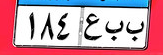

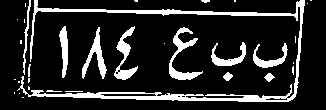

[[[[46, 16], [299, 16], [299, 95], [46, 95]], 'ببع ١٨٤', 0.9558360557063192]]
['ببع ١٨٤']


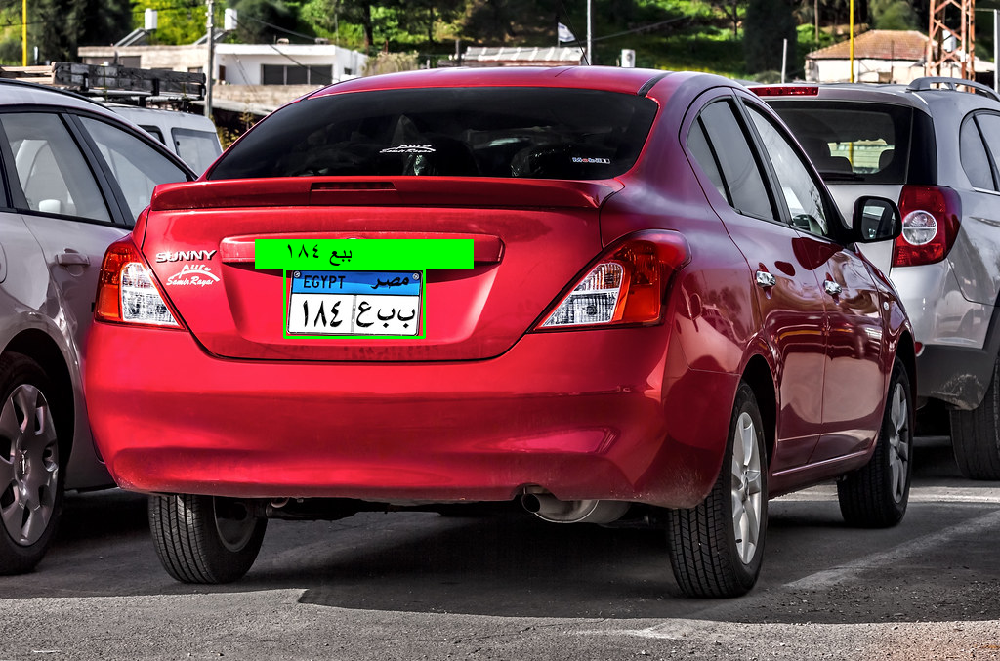

[INFO] Exiting. . . 


In [ ]:
main(img_path="/content/MicrosoftTeams-image (1).png")

[INFO] Working with image: /content/org_cca6d7ea-b291-4def-a219-ecde053655fe.jpeg
[INFO] Detecting. . . 
[INFO] Total 1 detections. . . 
[INFO] Looping through all detections. . . 
[INFO] Extracting BBox coordinates. . . 


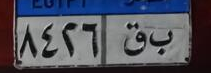

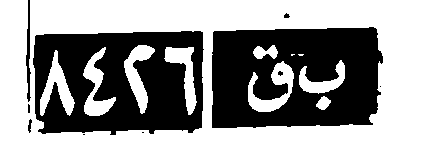

[[[[28, 29], [360, 29], [360, 134], [28, 134]], 'بق ٨٤٢٦', 0.8935461020399277]]
['بق ٨٤٢٦']


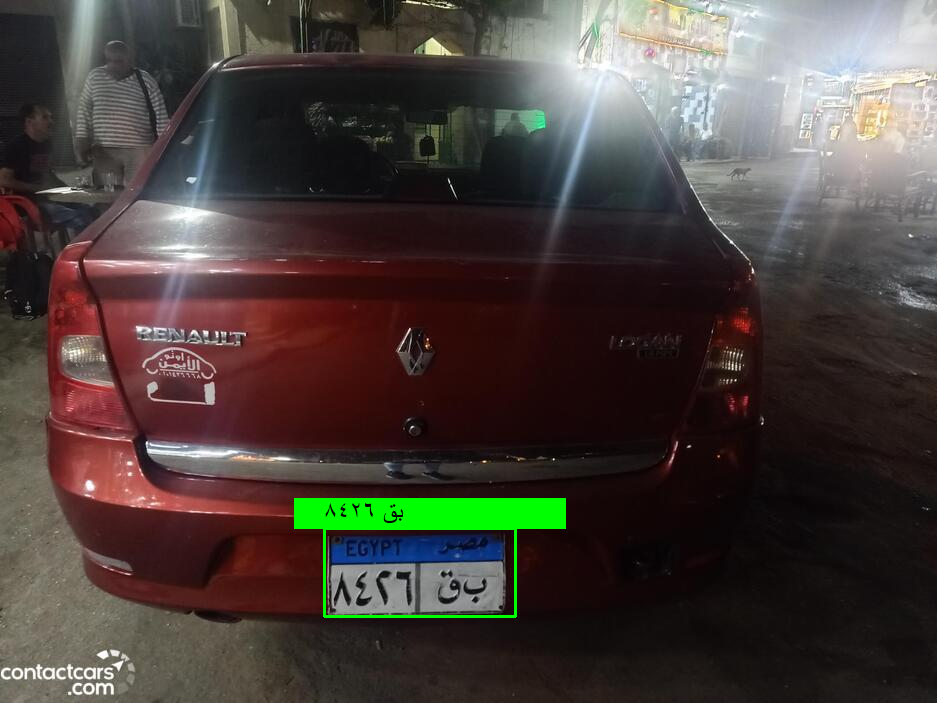

[INFO] Exiting. . . 


In [ ]:
main(img_path="/content/org_cca6d7ea-b291-4def-a219-ecde053655fe.jpeg")

[INFO] Working with image: /content/MicrosoftTeams-image (7).png
[INFO] Detecting. . . 
[INFO] Total 1 detections. . . 
[INFO] Looping through all detections. . . 
[INFO] Extracting BBox coordinates. . . 


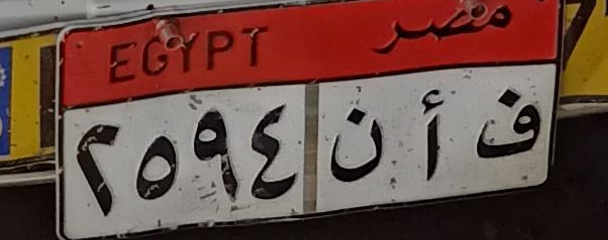

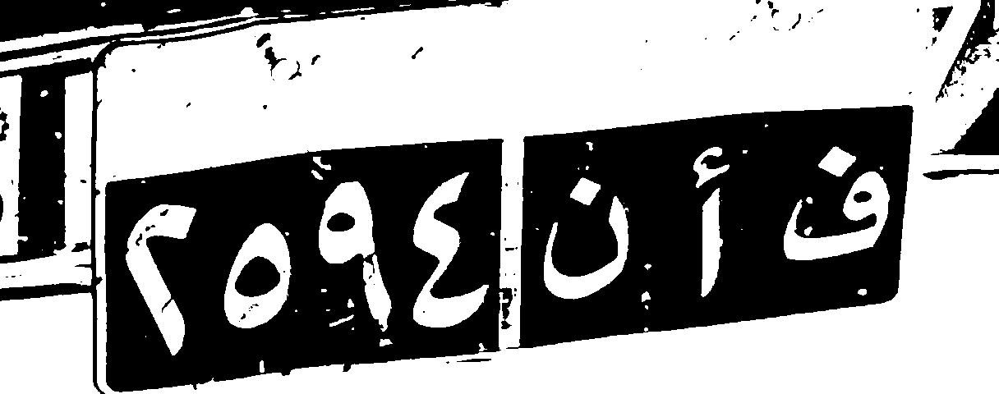

[[[[104, 152], [1106, 152], [1106, 468], [104, 468]], 'ف أ ن ٢٥٩٤', 0.44885289082983865]]
['ف أ ن ٢٥٩٤']


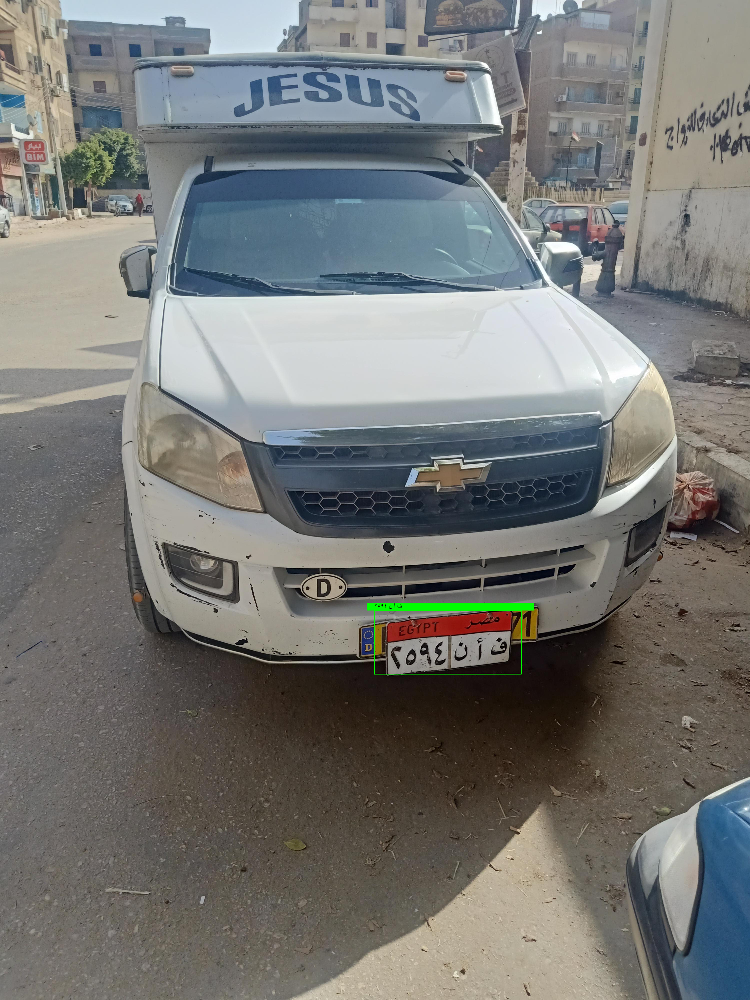

[INFO] Exiting. . . 


In [ ]:
main(img_path="/content/MicrosoftTeams-image (7).png")

[INFO] Working with image: /content/MicrosoftTeams-image (6).png
[INFO] Detecting. . . 
[INFO] Total 1 detections. . . 
[INFO] Looping through all detections. . . 
[INFO] Extracting BBox coordinates. . . 


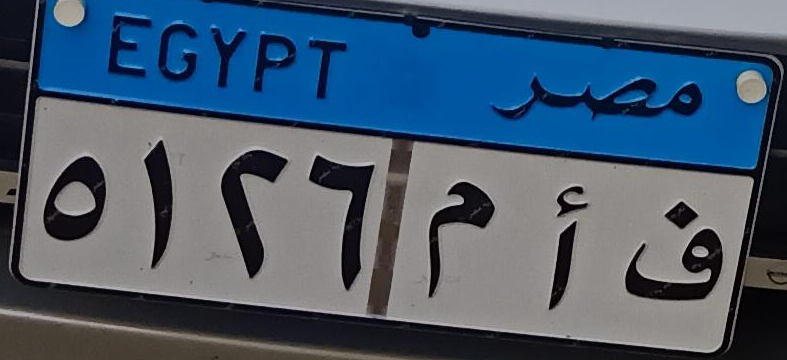

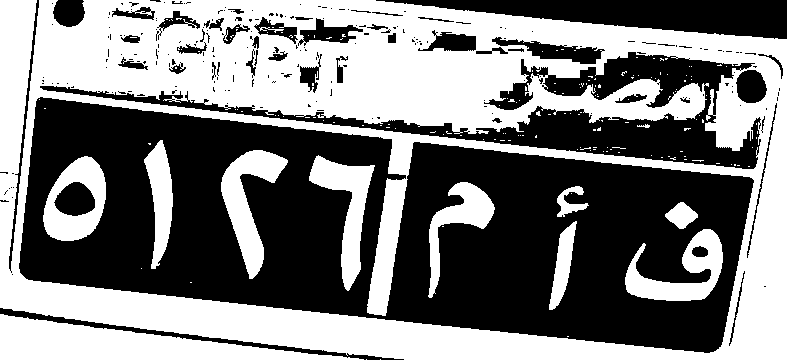

[[[[486, 54], [716, 54], [716, 132], [486, 132]], 'مصر', 0.41784058601699514], [[[21, 114], [743, 114], [743, 327], [21, 327]], 'ف أ م٥١٢٦', 0.4883793818878313], [[[110.05190907372004, -4.954954725939523], [366.85548890759753, 33.306087844006676], [348.94809092628, 119.95495472593953], [91.14451109240247, 80.69391215599333]], '٤6٧?7', 0.03880934992694025]]
['ف أ م٥١٢٦']


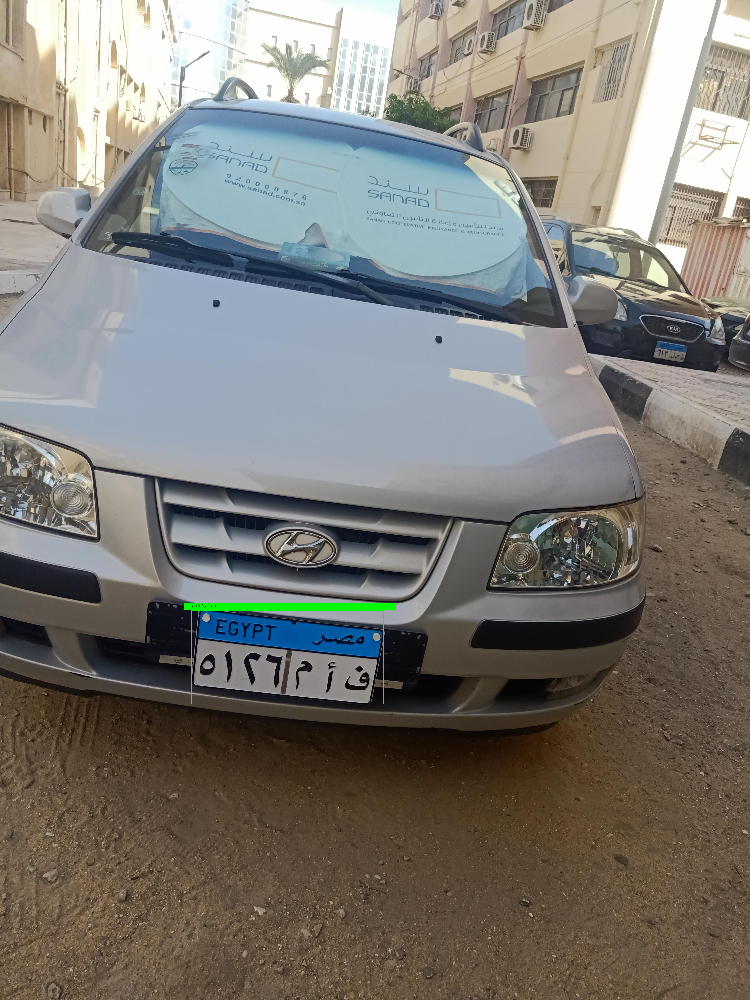

[INFO] Exiting. . . 


In [ ]:
main(img_path="/content/MicrosoftTeams-image (6).png")

[INFO] Working with image: /content/20180926144112dppp-urn_binary_dpa_com_20090101_180925-99-113047-filed.h.jpg
[INFO] Detecting. . . 
[INFO] Total 3 detections. . . 
[INFO] Looping through all detections. . . 
[INFO] Extracting BBox coordinates. . . 


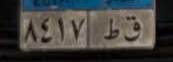

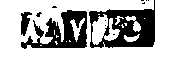

[[[[17, 13], [147, 13], [147, 49], [17, 49]], 'قط ٨٤١٧', 0.6299862671932671]]
['قط ٨٤١٧']
[INFO] Extracting BBox coordinates. . . 


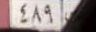

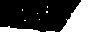

[]
['']
[INFO] Extracting BBox coordinates. . . 


[]
['']


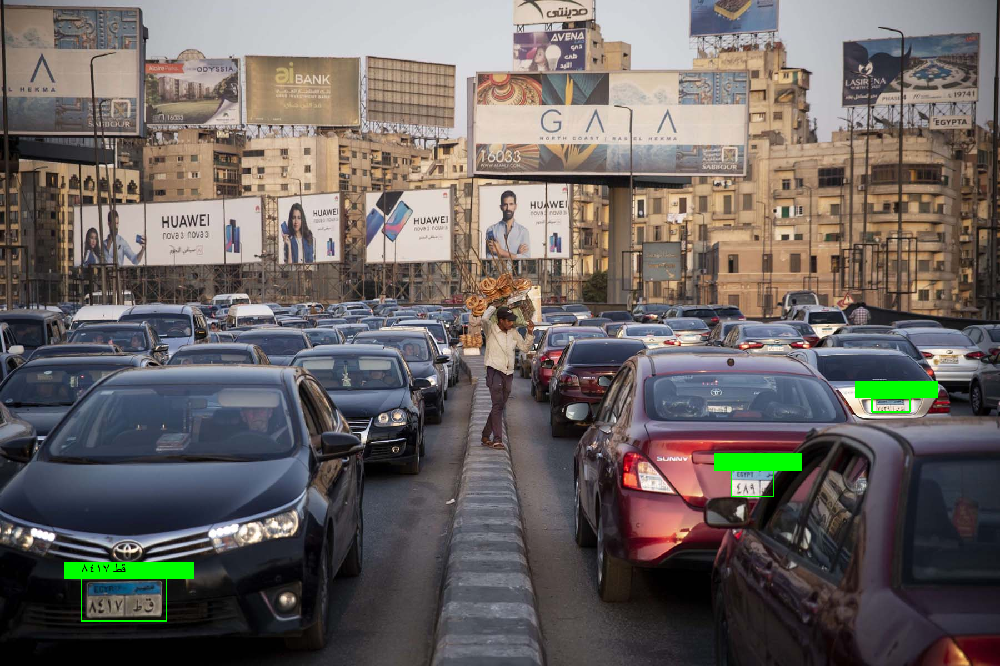

[INFO] Exiting. . . 


In [ ]:
main(img_path="/content/20180926144112dppp-urn_binary_dpa_com_20090101_180925-99-113047-filed.h.jpg")

In [ ]:
!unrar x /content/IMGs.rar


UNRAR 5.50 freeware      Copyright (c) 1993-2017 Alexander Roshal


Extracting from /content/IMGs.rar

Creating    IMGs                                                      OK
Extracting  IMGs/--------_------_jpg.rf.4b308aeff50a0e14a3cb859966efcc85.jpg       0%  OK 
Extracting  IMGs/------1146_jpg.rf.8dc2175d75c2cf846718af17e1b33466.jpg       0%  OK 
Extracting  IMGs/------124_jpg.rf.2cc9363d804a04227d5a3402b051d26e.jpg       0%  OK 
Extracting  IMGs/------146_jpg.rf.9d1d573aa3ba9afc59488b6825ddb2d1.jpg       0%  OK 
Extracting  IMGs/------1543_jpg.rf.683b565287d4bc89e63e260184278da6.jpg       0%  OK 
Extracting  IMGs/------1579_jpg.rf.d447e3b89508053417077f215382f7da.jpg       0%  OK 
Extracting  IMGs/------176_jpg.rf.05e45c0b02927a1836822b63e61f7040.jpg       0%  OK 
Extracting  IMGs/------1861_jpg.rf.6178bc1eff557db2626f4406880b3ce4.jpg       0%  OK 
Extracting  IMGs/------1944_jpg.rf.d778b9a80f88b91a49072ff1ab

In [ ]:
import os

dir_path = r'/content/IMGs/'
res = []

for path in os.listdir(dir_path):
    if os.path.isfile(os.path.join(dir_path, path)):
        res.append(os.path.join(dir_path, path))

print(res)

['/content/IMGs/IMG_--------_------_jpg.rf.cc87a1b8ba87324f0982012b20ec3f2a.jpg', '/content/IMGs/IMG_6556_JPG.rf.cadee3da78cc10d2a3a9d1da297bc8da.jpg', '/content/IMGs/IMG_20220926_072433_jpg.rf.ab1b1c87d000c4f38e46cdcc9a18a2d4.jpg', '/content/IMGs/IMG_--------_------_jpg.rf.6b5bae6891e731514deda3aa6952acdd.jpg', '/content/IMGs/IMG_--------_------_jpg.rf.6e777c8634f0ef3e3e96bd4d3b76a6f3.jpg', '/content/IMGs/IMG_6476_JPG.rf.a3b296c2df9280a28bf88dfd3d06f858.jpg', '/content/IMGs/IMG_6541_JPG.rf.561662c3e6a333d5a598a3bb34f60274.jpg', '/content/IMGs/IMG_--------_------_jpg.rf.96429ec2a6720fc72c7f148b864ccd40.jpg', '/content/IMGs/Screenshot_20220926_064623_jpg.rf.6c7999a76fec3a07e0665f3e153e32ca.jpg', '/content/IMGs/------6565_jpg.rf.a8bcccce237d4b6e74a8791c89d75ba4.jpg', '/content/IMGs/IMG_6360_JPG.rf.150a91d84e70440629f974e1ffeac59d.jpg', '/content/IMGs/m5_png.rf.9bab35e0366389b0cfec8f47cee04f3f.jpg', '/content/IMGs/IMG_--------_------_jpg.rf.2180bee7e785c2e331b42e0aa9b3009e.jpg', '/content

[INFO] Working with image: /content/IMGs/IMG_--------_------_jpg.rf.cc87a1b8ba87324f0982012b20ec3f2a.jpg
[INFO] Detecting. . . 
[INFO] Total 1 detections. . . 
[INFO] Looping through all detections. . . 
[INFO] Extracting BBox coordinates. . . 


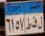

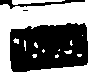

[]
['']


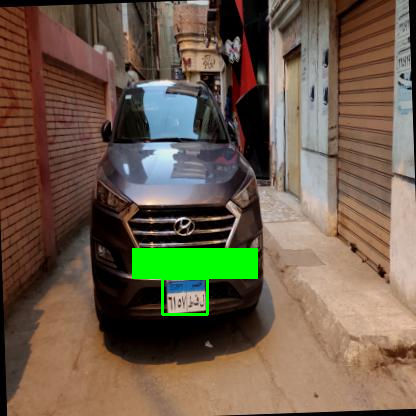

[INFO] Exiting. . . 
[INFO] Working with image: /content/IMGs/IMG_6556_JPG.rf.cadee3da78cc10d2a3a9d1da297bc8da.jpg
[INFO] Detecting. . . 
[INFO] Total 1 detections. . . 
[INFO] Looping through all detections. . . 
[INFO] Extracting BBox coordinates. . . 


[]
['']


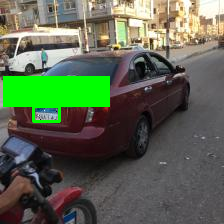

[INFO] Exiting. . . 
[INFO] Working with image: /content/IMGs/IMG_20220926_072433_jpg.rf.ab1b1c87d000c4f38e46cdcc9a18a2d4.jpg
[INFO] Detecting. . . 
[INFO] Total 0 detections. . . 
[INFO] Looping through all detections. . . 


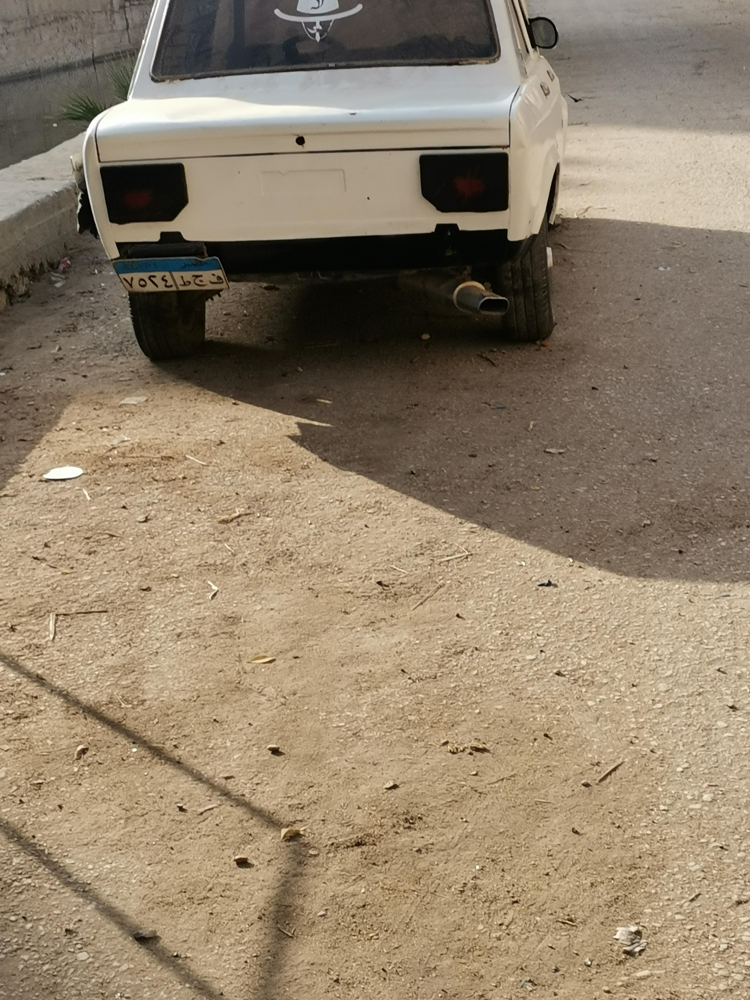

[INFO] Exiting. . . 
[INFO] Working with image: /content/IMGs/IMG_--------_------_jpg.rf.6b5bae6891e731514deda3aa6952acdd.jpg
[INFO] Detecting. . . 
[INFO] Total 1 detections. . . 
[INFO] Looping through all detections. . . 
[INFO] Extracting BBox coordinates. . . 


In [ ]:
for path in res:
  main(img_path=path)